# How does cinema view the world?

## Data preprocessing

### Imports

Here we import the required libraries and helper functions we will need for the analysis.

In [1]:
import os

import pandas as pd
import numpy as np

# We use google maps to get the coordinates of the cities/countries.
import googlemaps

# We use our own helper functions to load the data and get an embedding.
from helpers import load_data, get_embedding

# To track progress we use the tqdm package.
import tqdm

# To load our generated movie analysis we will use the json package.
import json

from sklearn.preprocessing import MinMaxScaler
from sklearn.manifold import TSNE

# We plot this using seaborn.
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import gaussian_kde

# We hide warnings to make the notebook a bit cleaner.
import warnings
warnings.filterwarnings("ignore")

# To parse genres from dataframe
import ast

# For mapping genres to colors
import hashlib

import plotly.express as px
import plotly.graph_objects as go

### Data loading

In [2]:
DATA_PATH = 'data/'

# We load the data using our helper function.
loaded_data = load_data(DATA_PATH)

# We initialize the google maps client using our API key.
gmaps = googlemaps.Client(key=os.environ['GOOGLE_MAPS_API_KEY'])

# We extract the variables from the loaded data.
character_metadata = loaded_data['character_metadata'] # The metadata of the characters.
movie_metadata = loaded_data['movie_metadata'] # The metadata of the movies.
plot_summaries = loaded_data['plot_summaries'] # The plot summaries of the movies.
embeddings = loaded_data['embeddings'] # The embeddings of the movies as a numpy array.
combined_plot_summaries = loaded_data['combined_plot_summaries'] # The movie summaries combined with their embeddings.
cities_in_country = loaded_data['cities_in_country'] # city list per country
city_country_analysis = loaded_data['city_country_analysis'] # The analysis of the cities and countries.
cities = city_country_analysis['cities'] # A list of all the cities.
countries = city_country_analysis['countries'] # A list of all the countries.
cities_movies = city_country_analysis['cities_movies'] # A dictionary mapping cities to movies.
countries_movies = city_country_analysis['countries_movies'] # A dictionary mapping countries to movies.
embeddings_of_movies_in_cities = city_country_analysis['embeddings_of_movies_in_cities'] # A dictionary mapping cities to embeddings of movies.
embeddings_of_movies_in_countries = city_country_analysis['embeddings_of_movies_in_countries'] # A dictionary mapping countries to embeddings of movies.

## General analysis by location

In [3]:
# We get the initial number of movies in movies_metadata.
initial_number_of_movies = len(movie_metadata)

# We get the number of movies in plot_summaries.
initial_number_of_movies_in_plot_summaries = len(plot_summaries)

# We get the number of movies in cities_movies.
initial_number_of_movies_in_cities = [cities_movies[city] for city in cities_movies]
# We flatten the list.
initial_number_of_movies_in_cities = [movie for movies in initial_number_of_movies_in_cities for movie in movies]

# We get the number of movies in countries_movies.
initial_number_of_movies_in_countries = [countries_movies[country] for country in countries_movies]
# We flatten the list.
initial_number_of_movies_in_countries = [movie for movies in initial_number_of_movies_in_countries for movie in movies]

# We get the number for cities
initial_number_of_movies_in_cities = len(set(initial_number_of_movies_in_cities))

# We get the number for countries
initial_number_of_movies_in_countries = len(set(initial_number_of_movies_in_countries))

# Data preparation
categories = ['Number of movies with metadata information', 
              'Movies with plot summaries', 
              'Movies with city present', 
              'Movies with country present']
values = [initial_number_of_movies, 
          initial_number_of_movies_in_plot_summaries, 
          initial_number_of_movies_in_cities, 
          initial_number_of_movies_in_countries]

# Sorting data
sorted_categories, sorted_values = zip(*sorted(zip(categories, values), key=lambda x: x[1], reverse=True))

# Creating the bar chart
fig = go.Figure(data=[
    go.Bar(
        x=sorted_values,
        y=sorted_categories,
        orientation='h',
        text=[f'{value:,}' for value in sorted_values],  # Adding text to the bars
        textposition='auto',
        marker_color=px.colors.qualitative.Set2,  # Using Plotly's Set2 color palette
        hoverinfo='none'
    )
])

# Updating layout
fig.update_layout(
    title='Number of Movies in Each Category',
    xaxis_title='Number of Movies',
    yaxis_title='Category',
    yaxis=dict(autorange="reversed"),  # To match the reversed sorting
    template="plotly_white"  # Using the 'plotly_white' theme for a clean look
)

# Saving the figure as an HTML file
fig.write_html('web/plots/number_of_movies.html')
fig.show()

In [4]:
import cartopy.crs as ccrs

# Initialize lists to store latitudes, longitudes, and sizes
lats, lngs, sizes, found_countries = [], [], [], []

# Loop over the countries and geocode them
for country, movies in countries_movies.items():
    geocode_result = gmaps.geocode(country)
    if geocode_result:
        lat = geocode_result[0]["geometry"]["location"]["lat"]
        lng = geocode_result[0]["geometry"]["location"]["lng"]
        lats.append(lat)
        lngs.append(lng)
        sizes.append(len(movies))
        found_countries.append(country)

In [5]:
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import plotly.express as px

top_n = 10
sorted_data = sorted(zip(found_countries, sizes), key=lambda x: x[1], reverse=True)[:top_n]
sorted_countries, sorted_sizes = zip(*sorted_data)

map_hover_text = [f'{country}: {size} movies' for country, size in zip(found_countries, sizes)]

fig = make_subplots(
    rows=1, cols=2,
    column_widths=[0.7, 0.3],  
    specs=[[{'type': 'scattergeo'}, {'type': 'bar'}]]
)


fig.add_trace(
    go.Scattergeo(
        lon=lngs,
        lat=lats,
        text=map_hover_text,
        mode='markers',
        marker=dict(
            size=[size / 10 for size in sizes],  
            opacity=0.8,
            color='red',
            line=dict(width=0),
            sizemode='area'
        ),
        hoverinfo='text'
    ),
    row=1, col=1
)


fig.add_trace(
    go.Bar(
        x=list(reversed(sorted_sizes)),
        y=list(reversed(sorted_countries)),
        orientation='h',
        text=list(reversed(sorted_sizes)),
        textposition='auto',
        marker_color=px.colors.qualitative.Plotly,
        hoverinfo='none',
        
    ),
    row=1, col=2
)


fig.update_geos(
    projection_type="natural earth",
    showcountries=True,
    showland=True,
    landcolor='lightgrey',
    showocean=True,
    oceancolor='lightblue',
    row=1, col=1,
)


fig.update_layout(
    barmode='group',
    bargap=0.15,  
    title_text="World Map with Movie Locations and Top Countries",
    showlegend=False
)


output_directory = 'web/plots/'
output_file = 'interactive_movie_locations.html'
if not os.path.exists(output_directory):
    os.makedirs(output_directory)

fig.write_html(os.path.join(output_directory, output_file))


print(f"Map saved to: {os.path.join(output_directory, output_file)}")

fig.show()


Map saved to: web/plots/interactive_movie_locations.html


## Embeddings

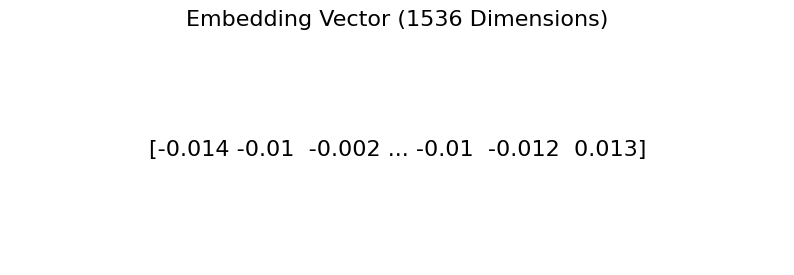

In [6]:
# We show the embedding of a random movie
random_movie = np.random.choice(len(embeddings))
embedding_to_visualize = embeddings[random_movie]
embedding_to_visualize = np.array([round(value, 3) for value in embedding_to_visualize])
fig, ax = plt.subplots(figsize=(10, 3))
ax.text(0.5, 0.5, str(embedding_to_visualize), fontsize=16, va='center', ha='center')
ax.set_title(f'Embedding Vector (1536 Dimensions)', fontsize=16)
ax.axis('off')
plt.savefig('web/plots/embedding.png')
plt.show()


In [7]:
# We calculate the T-SNE embedding of all movies
tsne = TSNE(n_components=2, random_state=0)
tsne_obj = tsne.fit_transform(embeddings) if not os.path.exists('data/tsne.npy') else np.load('data/tsne.npy')

# We save the T-SNE embedding
np.save('data/tsne.npy', tsne_obj)

In [8]:
NUMBER_OF_MOVIES_TO_PLOT = 1000
USE_SUBSET = False
search_terms = ["War", "Love", "India", "Korea", "China", "Sherlock Holmes"]

sampled_indices = np.random.choice(len(combined_plot_summaries), NUMBER_OF_MOVIES_TO_PLOT, replace=False)
if not USE_SUBSET:
    sampled_indices = range(len(combined_plot_summaries))

# If the indices point to a movie that is not in movie_metadata, we skip it
sampled_indices = [index for index in sampled_indices if combined_plot_summaries.iloc[index]['Wikipedia movie ID'] in movie_metadata['Wikipedia movie ID'].values]
sampled_movies = combined_plot_summaries.iloc[sampled_indices]
sampled_embeddings = np.array([embedding for embedding in sampled_movies['embedding']])
sampled_movie_ids = np.array([movie_id for movie_id in sampled_movies['Wikipedia movie ID']])

sample_movie_names = [
    movie_metadata[movie_metadata["Wikipedia movie ID"] == movie_id]["Movie name"].values[0]
    for movie_id in sampled_movie_ids
]
sampled_tsne_obj = tsne_obj[sampled_indices]

search_terms_embeddings = [get_embedding(term) for term in search_terms]
# Calculate cosine similarities for each search term
cosine_similarities_dict = {}
for term, search_embedding in zip(search_terms, search_terms_embeddings):
    cosine_similarities_dict[term] = np.dot(sampled_embeddings, search_embedding)
    
# Initial plot with the first search term
initial_term = search_terms[0]
tsne_df = pd.DataFrame({'X': sampled_tsne_obj[:, 0], 'Y': sampled_tsne_obj[:, 1], 'Movie': sample_movie_names, 'Color': cosine_similarities_dict[initial_term]})

In [9]:
# Creating the figure using graph_objects
fig = go.Figure(data=go.Scattergl(
    x=tsne_df['X'], 
    y=tsne_df['Y'],
    mode='markers',
    marker=dict(
        color=tsne_df['Color'],  # Set the color of markers
        colorscale='RdBu',  # Color scale
        colorbar=dict(title='Cosine Similarity')  # Color bar title
    ),
    # We also add the most similar keyword to the hover text
    text=tsne_df['Movie'],
    hoverinfo='text'
))

# Set the title of the plot
fig.update_layout(title=f'T-SNE plot of movie embeddings for search of {initial_term}')

# Dropdown menu for switching between terms
fig.update_layout(
    updatemenus=[
        dict(
            active=0,
            buttons=list(
                [
                    dict(
                        label=term,
                        method="update",
                        args=[{"marker.color": [cosine_similarities_dict[term]]},
                              {"title": f'T-SNE plot of movie embeddings for search of {term}'}]
                    ) for term in search_terms
                ]
            )
        )
    ]
)

fig.show()
# Save as html file
fig.write_html("web/plots/tsne.html", include_plotlyjs="cdn")

In [10]:
# We hardcode some countries to check.
countries_to_check = ['Germany', 'Vietnam', 'South Korea', 'India', 'North Korea', 'France']

# We get all movies in these countries.
movies_in_countries_to_check = [countries_movies[country] for country in countries_to_check]

# We get the embeddings of these movies from T-SNE by using the indices in combined_plot_summaries.
tsne_movies_in_countries_to_check = [tsne_obj[combined_plot_summaries[combined_plot_summaries['Wikipedia movie ID'].isin(movies)].index] for movies in movies_in_countries_to_check]

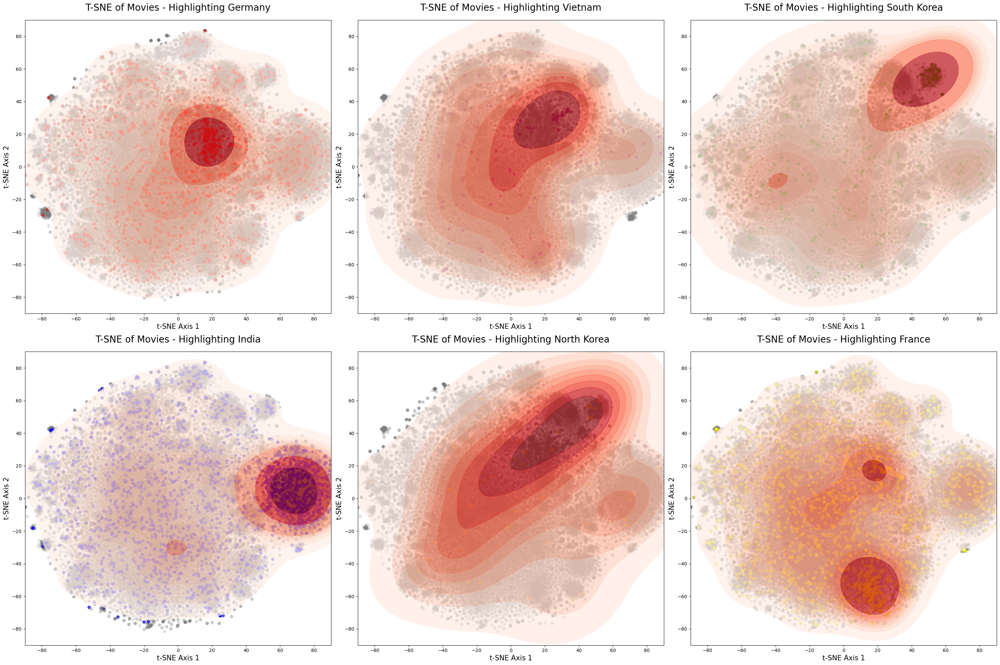

In [11]:
# Colors for each country
colors = ['red', 'purple', 'green', 'blue', 'orange', 'yellow']

# Determine the number of rows and columns for the subplots
n_countries = len(countries_to_check)
n_cols = 3
n_rows = (n_countries + n_cols - 1) // n_cols

# Create a figure with multiple axes
fig, axes = plt.subplots(n_rows, n_cols, figsize=(30, 10 * n_rows))

# Flatten the axes array for easy indexing
axes = axes.flatten()

for i, country in enumerate(countries_to_check):
    ax = axes[i]

    # Highlight the movies from the specific country
    country_movies = tsne_movies_in_countries_to_check[i]
    x_country, y_country = [movie[0] for movie in country_movies], [movie[1] for movie in country_movies]

    # Scatter plot for all movies
    ax.scatter(tsne_obj[:, 0], tsne_obj[:, 1], color='gray', alpha=0.2)

    # Scatter plot for the highlighted movies
    ax.scatter(x_country, y_country, alpha=0.5, color=colors[i])

    # KDE plot for the highlighted movies
    sns.kdeplot(x=x_country, y=y_country, ax=ax, cmap='Reds', shade=True,  alpha=0.7)
    # Set titles and labels
    ax.set_title(f'T-SNE of Movies - Highlighting {country}', pad=20, fontsize=20)
    ax.set_xlabel('t-SNE Axis 1', fontsize=15)
    ax.set_ylabel('t-SNE Axis 2', fontsize=15)
    
    # Set x adn y limits
    ax.set_xlim([-90, 90])
    ax.set_ylim([-90, 90])
    

# Adjust layout
plt.tight_layout()
plt.savefig('web/plots/tsne_countries.png')
plt.show()


We can clearly observe different and distinct clusters for movies from different countries. Germany and India show one of the stronger clusters.

#### Interpretting the clusters

We will now explain each of the countries cluster. We will do this by using our embeddings once again to compute the similarity to a number of different words.

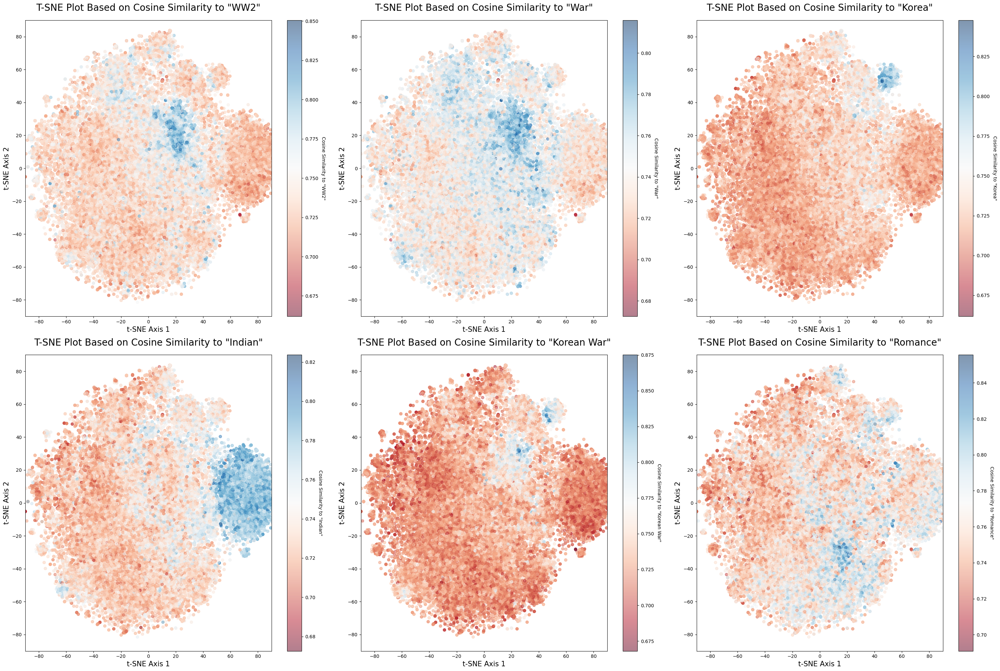

In [12]:
# Define search terms
search_terms = ["WW2", "War", "Korea", "Indian", "Korean War", "Romance"]

# Calculate cosine similarities for each search term
cosine_similarities_dict = {}
for term in search_terms:
    search_embedding = get_embedding(term)
    cosine_similarities_dict[term] = np.dot(embeddings, search_embedding)

# Determine the number of rows and columns for the subplots
n_terms = len(search_terms)
n_cols = 3
n_rows = (n_terms + n_cols - 1) // n_cols

# Create a figure with multiple axes
fig, axes = plt.subplots(n_rows, n_cols, figsize=(30, 10 * n_rows))

# Flatten the axes array for easy indexing
axes = axes.flatten()

# Create a scatter plot for each search term
for i, term in enumerate(search_terms):
    ax = axes[i]

    # Create a scatter plot using the cosine similarity for color
    scatter = ax.scatter(tsne_obj[:, 0], tsne_obj[:, 1], c=cosine_similarities_dict[term], cmap='RdBu', alpha=0.5)

    # Adding a color bar
    cbar = plt.colorbar(scatter, ax=ax)
    cbar.set_label(f'Cosine Similarity to "{term}"', rotation=270, labelpad=15)

    # Set titles and labels
    ax.set_title(f'T-SNE Plot Based on Cosine Similarity to "{term}"', pad=20, fontsize=20)
    ax.set_xlabel('t-SNE Axis 1', fontsize=15)
    ax.set_ylabel('t-SNE Axis 2', fontsize=15)
    
    # Set x and y limits
    ax.set_xlim([-90, 90])
    ax.set_ylim([-90, 90])

# Adjust layout
plt.tight_layout()
plt.savefig('web/plots/tsne_explained.png')
plt.show()


We can make a number of observations:
- The ***German*** cluster matches almost perfectly with the WW2 cluster which makes sense.
- The ***Vietnam*** cluster matches closely with the War cluster.
- The ***South Korean*** cluster depicts Korean movies, no surprise here.
- The ***Indian*** cluster is one of the biggest and most separate clusters and depicts general themes that appear in Indian culture.
- The ***North Korean*** cluster is interesting as it seems to be a combination of both War and Korean which would make sense and we interpreted it as it being depicted mostly in movies about the Korean War.
- The ***France*** cluster is close to the Romance cluster. We will show this relation to be stronger in subsequent chapters but we can already observe a bias.

We can conclude that countries depicting certain countries are usually similar in plot and we will enforce and explore this further in the rest of the chapters.

## Genre distributions & Bias

#### Extracting genres by location

In [13]:
def get_genres_by_location(locations_movies, movie_metadata):
    location_genre_count = {}

    for location, movie_ids in locations_movies.items():
        genre_count = {}

        for movie_id in movie_ids:
            genres_series = movie_metadata.loc[movie_metadata["Wikipedia movie ID"] == int(movie_id), "Movie genres (Freebase ID:name tuples)"]
            if not genres_series.empty:
                genres_str = genres_series.values[0]
                genres = list(ast.literal_eval(genres_str).values())

                for genre_name in genres:
                    genre_count[genre_name] = genre_count.get(genre_name, 0) + 1

        # Store the genre counts for the current location
        location_genre_count[location] = genre_count

    return location_genre_count


In [14]:
city_genre = get_genres_by_location(cities_movies, movie_metadata)
country_genre = get_genres_by_location(countries_movies, movie_metadata)

### Genres distribution by location

In [15]:
GENRE_SIGNIFICANCE_THRESHOLD = 0.03  # Threshold for genre representation

def hash_color(genre, s=0.5):
    hash = hashlib.md5(genre.encode()).hexdigest()
    r, g, b = int(hash[0:2], 16), int(hash[2:4], 16), int(hash[4:6], 16)
    # Scale down the RGB values to the desired brightness level
    r, g, b = [int(s * val + (1 - s) * 255) for val in (r, g, b)]
    return f'#{r:02x}{g:02x}{b:02x}'

def visualize_genres(locations_genres):
    fig, axs = plt.subplots(2, 2, figsize=(12, 12)) 
    axs = axs.flatten()

    for i, (location, genres) in enumerate(locations_genres.items()):
        total_count = sum(genres.values())

        # Filter and sort genres
        filtered_genres_counts = {genre: (count / total_count) * 100 for genre, count in genres.items() if (count / total_count) >= GENRE_SIGNIFICANCE_THRESHOLD}
        sorted_genres_counts = dict(sorted(filtered_genres_counts.items(), key=lambda item: item[1], reverse=True))

        # Create a list of colors for the current location based on the genre color map
        bar_colors = [hash_color(genre) for genre in sorted_genres_counts.keys()]

        labels = list(sorted_genres_counts.keys())
        sizes = list(sorted_genres_counts.values())

        # Creating the bar chart in subplot
        bars = axs[i].bar(labels, sizes, color=bar_colors)
        axs[i].set_title(f'{location}', fontweight="bold")
        axs[i].tick_params(axis='x', rotation=45) 
        axs[i].set_ylabel('Percentage (%)') 

        # Add percentages on top of the bars
        for bar in bars:
            height = bar.get_height()
            axs[i].annotate(f'{height:.1f}%',
                            xy=(bar.get_x() + bar.get_width() / 2, height),
                            xytext=(0, 3), 
                            textcoords="offset points",
                            ha='center', va='bottom')

    plt.tight_layout()
    plt.show()


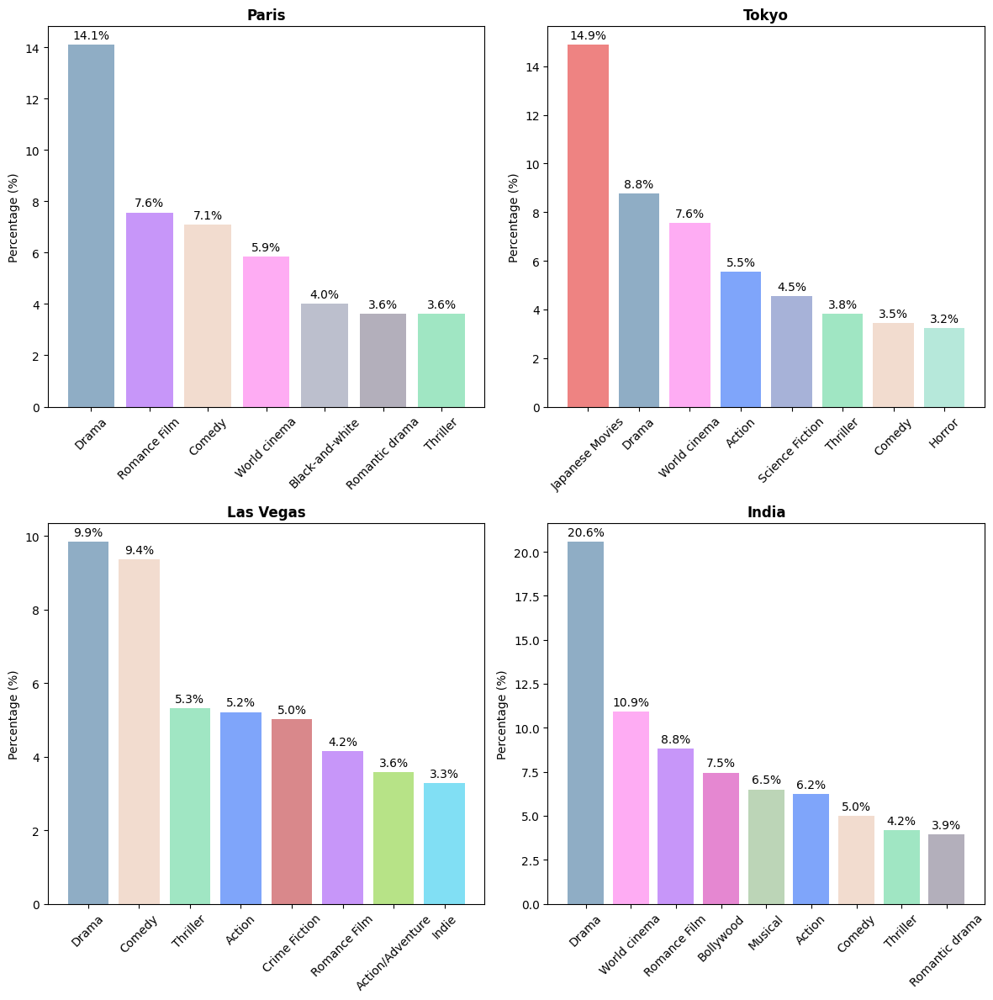

In [16]:
locations_genres = {
    "Paris": city_genre["Paris"],
    "Tokyo": city_genre["Tokyo"],
    "Las Vegas": city_genre["Las Vegas"],
    "India": country_genre["India"],
}

visualize_genres(locations_genres)

## Observations on Genre Distributions

- In **Paris**, the prevalence of romance-themed films mirrors the city's romantic reputation.
- **Tokyo**'s chart is topped by Japanese cinema, reflecting strong cultural influences.
- The Indian market is heavily inclined towards dramas, musicals and Bollywood.
- Comedies and crime fictions are popular in **Las Vegas**, which represents the city's cinematic cliches.
- The term **World Cinema** refers to non-Hollywood films, and its presence makes sense in the given locations.



### Top locations by genre

In [17]:
def visualize_top_locations_for_genre(location_genre_data, genre, top_n=10, threshold=100):
    # Calculate the total number of movies and the percentage for the specified genre
    location_genre_percentage = {}
    for location, genres in location_genre_data.items():
        total_movies = sum(genres.values())
        if total_movies > threshold:  # Only consider countries with more than 'threshold' movies
            genre_count = genres.get(genre, 0)
            genre_percentage = (genre_count / total_movies) * 100
            location_genre_percentage[location] = genre_percentage

    # Sort countries based on the percentage of the specified genre
    sorted_locations = sorted(location_genre_percentage.items(), key=lambda x: x[1], reverse=True)[:top_n]

    locations = [location for location, percentage in sorted_locations]
    percentages = [percentage for location, percentage in sorted_locations]

    # Create the bar chart
    plt.figure(figsize=(10, 6))
    plt.bar(locations, percentages, color='skyblue')

    # Add labels and title to the chart
    plt.xlabel('Locations')
    plt.ylabel('Percentage of ' + genre)
    plt.title(f'Top {top_n} Locations for "{genre}" Genre (Minimum {threshold} Total Movies)')

    for i, percentage in enumerate(percentages):
        plt.text(i, percentage, f'{percentage:.1f}%', ha='center', va='bottom')

    plt.xticks(rotation=45) 
    plt.tight_layout() 
    plt.show()


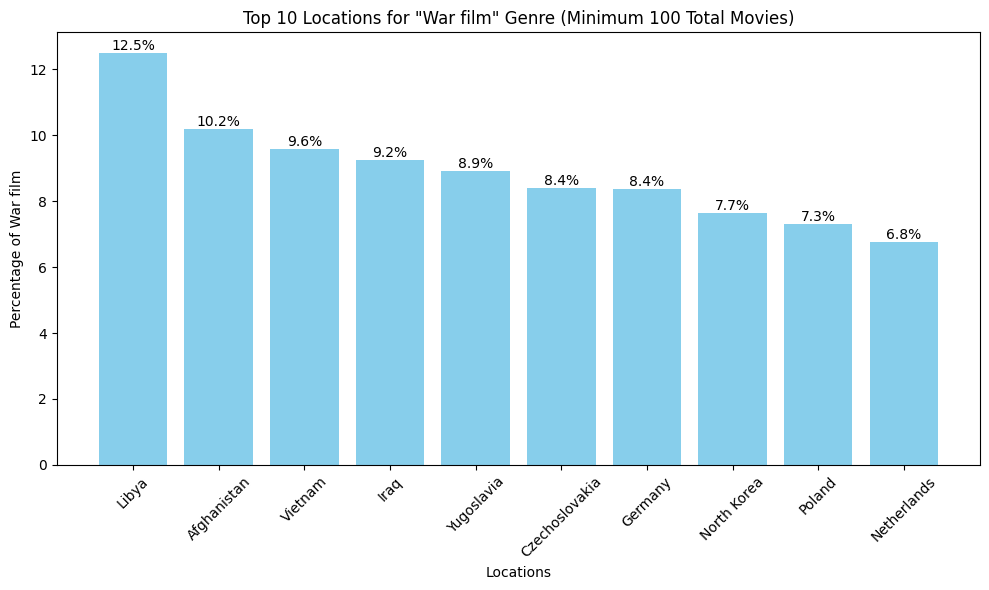

In [18]:
visualize_top_locations_for_genre(country_genre, 'War film', top_n=10, threshold=100)

## Exploring how different countries view each other

To go futher with our analysis we think it could be great to change our point of view and filter out some movies made from a particular country. This would allow to see how our metrics may change depending from where the movie was made.

For example we could explore the percentage of representation the city of London has from movies made outside of the United Kingdom.

In [19]:
from helpers import extract_country

# Adds the 'Country' column to the df
movie_metadata['Country'] = movie_metadata['Movie countries (Freebase ID:name tuples)'].apply(extract_country)

In [20]:
### Standardize country names in movie_metadata (for our example)

movie_metadata['Country'] = movie_metadata['Country'].replace('United States of America', 'United States')
movie_metadata['Country'] = movie_metadata['Country'].replace('England', 'United Kingdom')
movie_metadata['Country'] = movie_metadata['Country'].replace('Kingdom of Great Britain', 'United Kingdom')
movie_metadata['Country'] = movie_metadata['Country'].replace('West Germany', 'Germany')
movie_metadata['Country'] = movie_metadata['Country'].replace('German Democratic Republic', 'Germany')
movie_metadata['Country'] = movie_metadata['Country'].replace('Weimar Republic', 'Germany')
movie_metadata['Country'] = movie_metadata['Country'].replace('Serbia and Montenegro', 'Serbia')
movie_metadata['Country'] = movie_metadata['Country'].replace('Soviet Union', 'Russia')


In [16]:
## Cities of interest COI
city_of_interest = [
    'London'
]

In [17]:
# Extract list of movie IDS where the plot takes place in the city of intereset
coi_movies = {}
for city in city_of_interest:
    coi_movies[city] = cities_movies.get(city, [])

In [18]:
# Filter movie IDs based on the country in movie_metadata (takes out movies from the origin country the of COI)
foreign_movies = {}
for city, movie_ids in coi_movies.items():
    filtered_movie_ids = []
    for movie_id in movie_ids:
        # Matches movie IDs between datasets
        matching_movies = movie_metadata[movie_metadata['Wikipedia movie ID'] == movie_id]
        if not matching_movies.empty:
            movie_country = matching_movies.iloc[0]['Country']
            city_country = next((country for country, cities in cities_in_country.items() if city in cities), None)
            if movie_country is not None and movie_country != city_country:
                filtered_movie_ids.append(movie_id)
    foreign_movies[city] = filtered_movie_ids

In [19]:
# Create a dictionary to regroup movie IDs by country of production
regrouped_by_country = {}

for city, movie_ids in foreign_movies.items():
    for movie_id in movie_ids:
        matching_movies = movie_metadata[movie_metadata['Wikipedia movie ID'] == movie_id]
        if not matching_movies.empty:
            movie_country = matching_movies.iloc[0]['Country']
            if movie_country is not None:
                if movie_country not in regrouped_by_country:
                    regrouped_by_country[movie_country] = []
                regrouped_by_country[movie_country].append(movie_id)

In [20]:
# Create a dictionary to regroup movie IDs by cities of interest and country
regrouped_by_coi_and_country = {}

for city, movie_ids in foreign_movies.items():
    city_dict = {}
    for movie_id in movie_ids:
        matching_movies = movie_metadata[movie_metadata['Wikipedia movie ID'] == movie_id]
        if not matching_movies.empty:
            movie_country = matching_movies.iloc[0]['Country']
            if movie_country is not None:
                if movie_country not in city_dict:
                    city_dict[movie_country] = []
                city_dict[movie_country].append(movie_id)
    regrouped_by_coi_and_country[city] = city_dict

In [21]:
## Get countries coordinates 
gmaps = googlemaps.Client(key=os.environ['GOOGLE_MAPS_API_KEY'])
country_coordinates = {}

for country in countries:
        geocode_result = gmaps.geocode(country)
        if geocode_result:
            lat = geocode_result[0]["geometry"]["location"]["lat"]
            lng = geocode_result[0]["geometry"]["location"]["lng"]
            country_coordinates[country] = (lat, lng)
        else:
            country_coordinates[country] = (None, None)

In [22]:
# Get cities coordinates 
city_coordinates = {}

for city in cities:
    geocode_result = gmaps.geocode(city)
    if geocode_result:
        lat = geocode_result[0]["geometry"]["location"]["lat"]
        lng = geocode_result[0]["geometry"]["location"]["lng"]
        city_coordinates[city] = (lat, lng)
    else:
        city_coordinates[city] = (None, None)

In [23]:
### Scaled by % :  a country movies in the coi divided by the total countries movies 

coi = city_of_interest[0]
data_foreign = {}

for country in regrouped_by_coi_and_country[coi].keys() :
    
    df = pd.DataFrame({
        'Latitude' : [country_coordinates[country][0]],
        'Longitude' : [country_coordinates[country][1]],
        ### Scale by % :  of a country movies in the coi divided by the total coi movies
        #'Representation of COI in %' : (len(regrouped_by_city_and_country[coi][country])/len(foreign_movies[coi]))*100
        'Representation of COI in %' : (len(regrouped_by_coi_and_country[coi][country])/len(countries_movies[country]))*100
    })
    data_foreign[country] = df

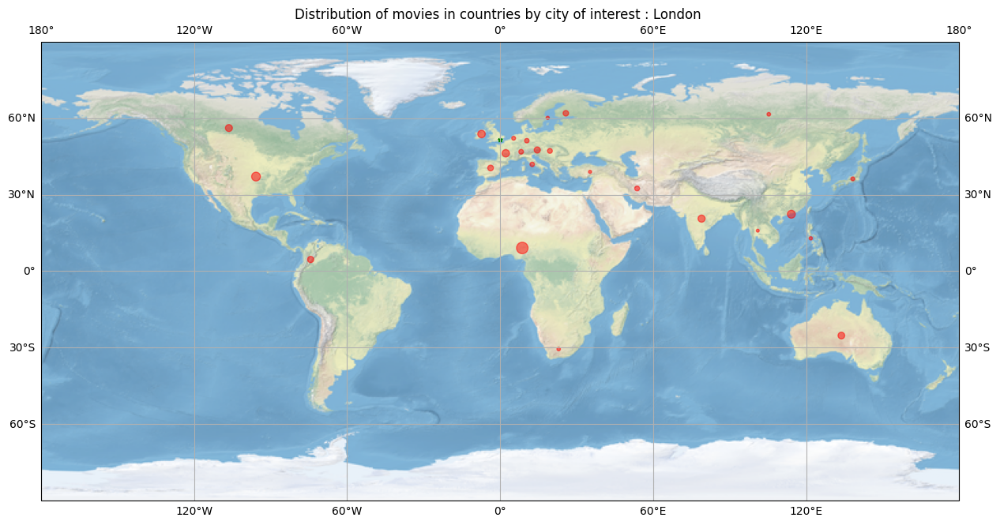

In [24]:
import cartopy.crs as ccrs

# Init 
lats, lngs, sizes = [], [], []

# Load data
for df in data_foreign.values():
    lats.append(df['Latitude'].iloc[0])
    lngs.append(df['Longitude'].iloc[0])
    sizes.append(df['Representation of COI in %'].iloc[0] * 15)

# Plotting
fig, ax = plt.subplots(figsize=(15, 10), subplot_kw={'projection': ccrs.PlateCarree()})

ax.stock_img()


# Size of each point is proportional to the representation of COI
ax.scatter(lngs, lats, s=sizes, alpha=0.5, color='red', transform=ccrs.Geodetic())
# Coi plot
ax.scatter(city_coordinates[coi][1],city_coordinates[coi][0], s=15, marker='*', color='green', transform=ccrs.Geodetic())
ax.gridlines(draw_labels=True)

plt.title(f"Distribution of movies in countries by city of interest : {coi} ")
plt.show()

Nigeria comes as the country where the plots most frequently takes place in London, 7.4 % of the time. It has to be said we only have 27 movies from Nigeria in our dataset.

This country exclusion analysis could be easily generalized to measure shifts in other metrics such as genres or the evolution of good versus evil characters. We could then try to highlight particular views or relationship between countries. 

## Exploring how locations changed their view in time

We will first analyze the time component of the release date of each movie and visualize this distribution

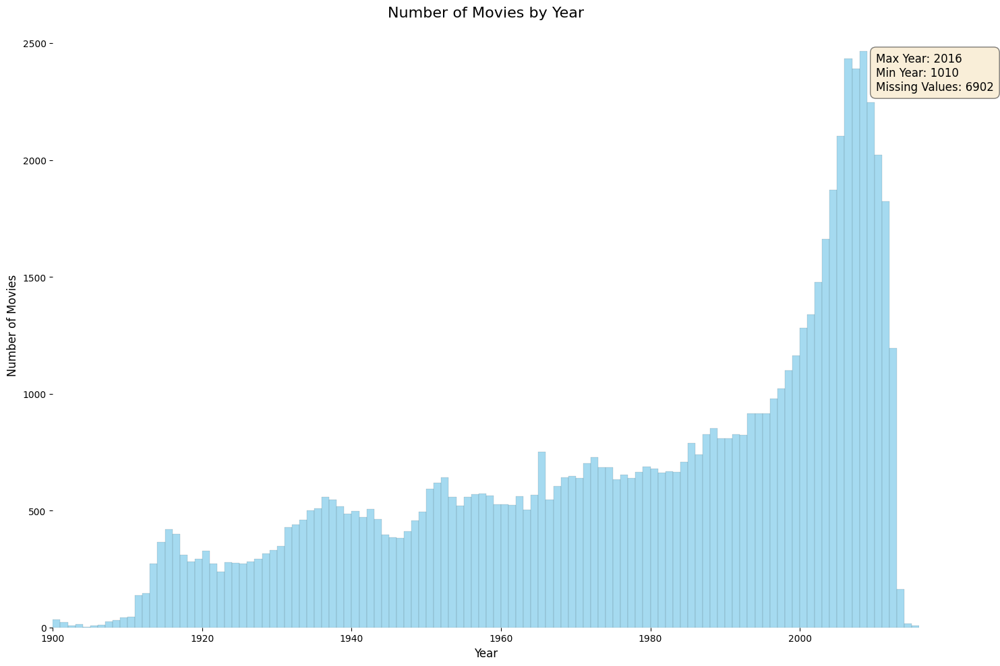

In [22]:
movie_years = movie_metadata['Movie release date'].str.extract(r'(\d{4})', expand=False)

# Calculate min, max, and missing values
min_year = movie_years.dropna().astype(int).min()
max_year = movie_years.dropna().astype(int).max()
missing_values = movie_years.isnull().sum()

# Drop NA values and convert to int
movie_years = movie_years.dropna().astype(int)

# Histogram of movie years
fig, ax = plt.subplots(figsize=(15, 10))
sns.histplot(movie_years, bins=(max_year - min_year), color='skyblue', ax=ax, kde=False)

# Set labels and title
ax.set_xlabel('Year', fontsize=12)
ax.set_ylabel('Number of Movies', fontsize=12)
ax.set_title('Number of Movies by Year', fontsize=16)

ax.set_xlim([1900, max_year])

# Adding text about min, max, and missing values
textstr = f'Max Year: {max_year}\nMin Year: {min_year}\nMissing Values: {missing_values}'
ax.text(0.95, 0.95, textstr, transform=ax.transAxes, fontsize=12,
        verticalalignment='top', bbox=dict(boxstyle='round,pad=0.5', facecolor='wheat', alpha=0.5))

plt.tight_layout()
sns.despine(left=True, bottom=True)
plt.savefig('C:/EPFL/ada-2023-project-tada/number_of_movies_by_year.png', dpi=300)  # Specify the path and filename

plt.show()


We seem to have a decent number of movies for the 1900-2016 range with more movies towards the end of the range but still sufficient in all ranges to make an analysis.

#### Case Study: Evolution of trends in France

We will explore how movie trends changed in France as time went on.

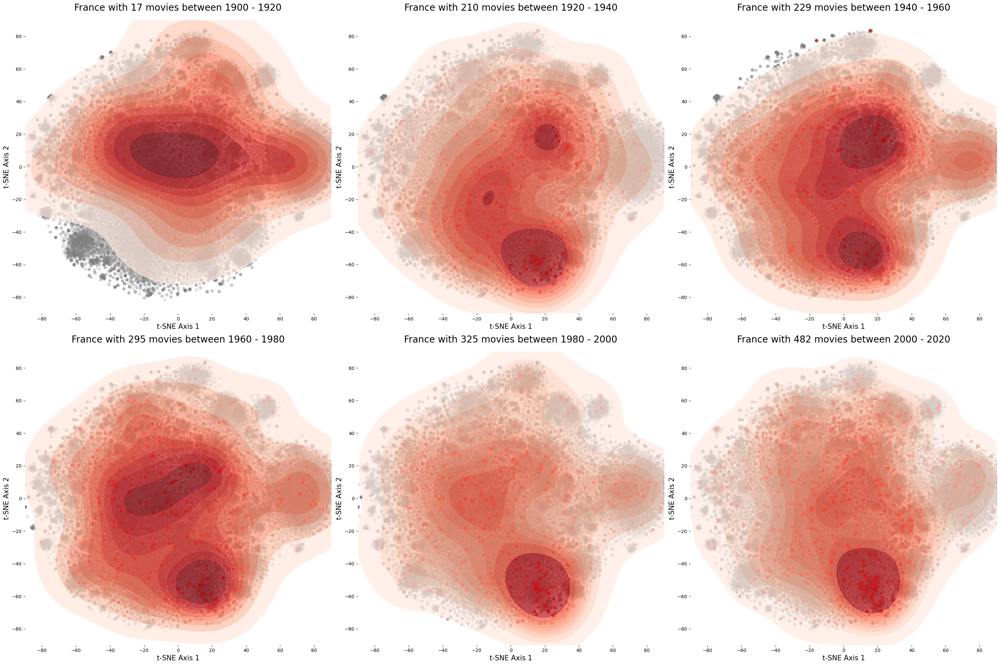

In [24]:
country_to_check = 'France'

movies_in_country_to_check = countries_movies[country_to_check]

movie_years = movie_metadata['Movie release date'].str.extract(r'(\d{4})', expand=False)
movie_metadata['year'] = movie_years
movie_metadata['year'] = movie_metadata['year'].fillna(-1).astype(int)

# Define the time periods
time_periods = range(1900, 2017, 20)

n_ranges = len(time_periods)
n_cols = 3
n_rows = (n_ranges + n_cols - 1) // n_cols

fig, axes = plt.subplots(n_rows, n_cols, figsize=(30, 10 * n_rows))

axes = axes.flatten()

for i, start_year in enumerate(time_periods):
    end_year = start_year + 20
    
    # Filter movies released in the current time period
    period_movies = movie_metadata[(movie_metadata['year'] < end_year) & (movie_metadata['year'] >= start_year)]
    
    ax = axes[i]
    
    movies_in_country_to_check_in_time_period = period_movies[period_movies['Wikipedia movie ID'].isin(movies_in_country_to_check)]['Wikipedia movie ID']
    tsne_movies_in_country_to_check = tsne_obj[combined_plot_summaries['Wikipedia movie ID'].isin(movies_in_country_to_check_in_time_period)]

    country_movies = tsne_movies_in_country_to_check
    x_country, y_country = [movie[0] for movie in country_movies], [movie[1] for movie in country_movies]

    # Scatter plot for all movies
    ax.scatter(tsne_obj[:, 0], tsne_obj[:, 1], color='gray', alpha=0.2)

    # Scatter plot for the highlighted movies
    ax.scatter(x_country, y_country, alpha=0.5, color='red')

    # KDE plot for the highlighted movies
    sns.kdeplot(x=x_country, y=y_country, ax=ax, cmap='Reds', shade=True,  alpha=0.7)
    
    # Set titles and labels
    ax.set_title(f'{country_to_check} with {len(movies_in_country_to_check_in_time_period)} movies between {start_year} - {end_year}', pad=20, fontsize=20)
    ax.set_xlabel('t-SNE Axis 1', fontsize=15)
    ax.set_ylabel('t-SNE Axis 2', fontsize=15)
    
    # Set x adn y limits
    ax.set_xlim([-90, 90])
    ax.set_ylim([-90, 90])
    

# Adjust layout
plt.tight_layout()
sns.despine(left=True, bottom=True)
plt.savefig('C:/EPFL/ada-2023-project-tada/number_of_movies_france.png', dpi=300)  # Specify the path and filename

plt.show()

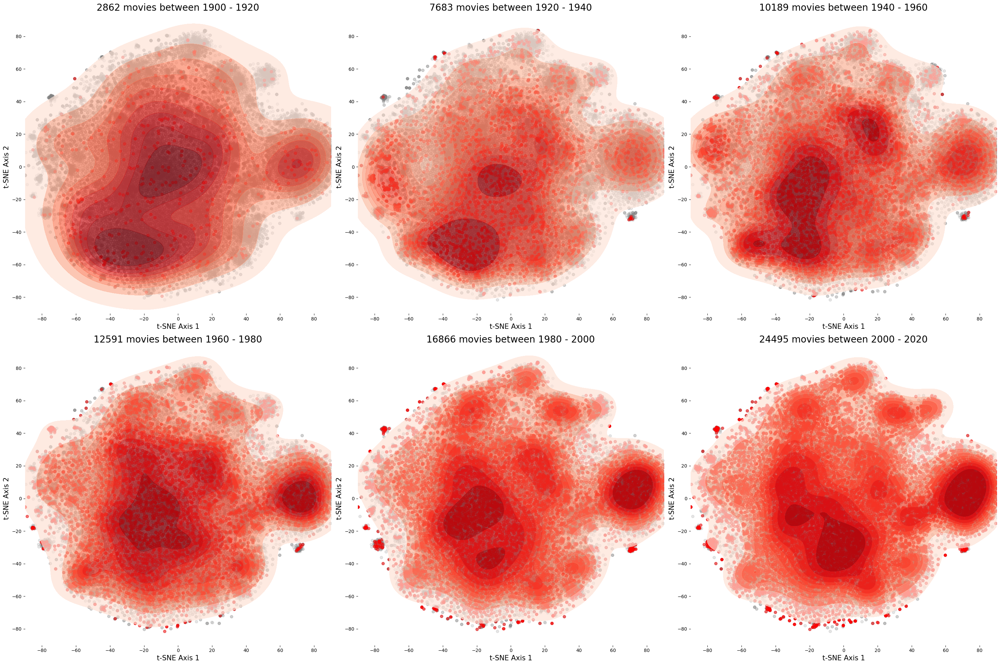

In [34]:
movies_in_country_to_check = list(countries_movies.values())


movie_years = movie_metadata['Movie release date'].str.extract(r'(\d{4})', expand=False)
movie_metadata['year'] = movie_years
movie_metadata['year'] = movie_metadata['year'].fillna(-1).astype(int)

# Define the time periods
time_periods = range(1900, 2017, 20)

n_ranges = len(time_periods)
n_cols = 3
n_rows = (n_ranges + n_cols - 1) // n_cols

fig, axes = plt.subplots(n_rows, n_cols, figsize=(30, 10 * n_rows))

axes = axes.flatten()

for i, start_year in enumerate(time_periods):
    end_year = start_year + 20
    
    # Filter movies released in the current time period
    period_movies = movie_metadata[(movie_metadata['year'] < end_year) & (movie_metadata['year'] >= start_year)]
    
    ax = axes[i]
    
    movies_in_country_to_check_in_time_period = period_movies['Wikipedia movie ID']
    tsne_movies_in_country_to_check = tsne_obj[combined_plot_summaries['Wikipedia movie ID'].isin(movies_in_country_to_check_in_time_period)]

    country_movies = tsne_movies_in_country_to_check
    x_country, y_country = [movie[0] for movie in country_movies], [movie[1] for movie in country_movies]

    # Scatter plot for all movies
    ax.scatter(tsne_obj[:, 0], tsne_obj[:, 1], color='gray', alpha=0.2)

    # Scatter plot for the highlighted movies
    ax.scatter(x_country, y_country, alpha=0.5, color='red')

    # KDE plot for the highlighted movies
    sns.kdeplot(x=x_country, y=y_country, ax=ax, cmap='Reds', shade=True,  alpha=0.7)
    
    # Set titles and labels
    ax.set_title(f'{len(movies_in_country_to_check_in_time_period)} movies between {start_year} - {end_year}', pad=20, fontsize=20)
    ax.set_xlabel('t-SNE Axis 1', fontsize=15)
    ax.set_ylabel('t-SNE Axis 2', fontsize=15)
    
    # Set x adn y limits
    ax.set_xlim([-90, 90])
    ax.set_ylim([-90, 90])
    

# Adjust layout
plt.tight_layout()
sns.despine(left=True, bottom=True)
plt.savefig('C:/EPFL/ada-2023-project-tada/number_of_movies_world.png', dpi=300)  # Specify the path and filename

plt.show()

We can observe something very interesting about our analysis on France and more exactly that between 1920 - 1960 there was a clear second cluster present in the area we explored in section one as WW2 cluster. Thus we can observe that all newer movies about France are usually about romance and a lot of past movies are about WW2.

#### Genres over time

We will explore how genres for a number of countries went up and down in popularity.

In [35]:
def get_genres_by_location_and_year(locations_movies, movie_metadata):
    year_location_genre_count = {}

    for location, movie_ids in locations_movies.items():
        for movie_id in movie_ids:
            movie_row = movie_metadata[movie_metadata["Wikipedia movie ID"] == int(movie_id)]

            if not movie_row.empty:
                movie_release_date = movie_row["Movie release date"].values[0]
                year = movie_release_date[:4] if pd.notna(movie_release_date) else 'Unknown'

                genres_str = movie_row["Movie genres (Freebase ID:name tuples)"].values[0]
                genres = list(ast.literal_eval(genres_str).values())

                if year not in year_location_genre_count:
                    year_location_genre_count[year] = {}
                if location not in year_location_genre_count[year]:
                    year_location_genre_count[year][location] = {}

                for genre_name in genres:
                    genre_count = year_location_genre_count[year][location]
                    genre_count[genre_name] = genre_count.get(genre_name, 0) + 1

    return year_location_genre_count

In [36]:
year_city_genre = get_genres_by_location_and_year(cities_movies, movie_metadata)
year_country_genre = get_genres_by_location_and_year(countries_movies, movie_metadata)

In [37]:
def genre_trend_visualization(location, genre, location_year_genre_data, years, mark_years=[], mark_years_labels=[]):
    film_counts = []

    for year in years:
        year_str = str(year)
        count = 0
        if year_str in location_year_genre_data and location in location_year_genre_data[year_str]:
            count = location_year_genre_data[year_str][location].get(genre, 0)
        film_counts.append(count)
    plt.figure(figsize=(10, 6))
        
    # If we have mark years we add a marker to the plot and add the labels
    for i, year in enumerate(mark_years):
        plt.axvline(x=year, color='gray', linestyle='--')
        plt.text(year, np.max(film_counts), mark_years_labels[i], ha='center', va='bottom')
        
    plt.plot(years, film_counts, marker='o')
    plt.title(f'Number of {genre} Movies in {location} {str(years)}')
    plt.xlabel('Year')
    plt.ylabel('Number of Movies')
    plt.grid(True)
    plt.show()

Before jumping in it is important to denote the difference between a movie filmed in a country and one where the action is depicted as. For example, a new popular Netflix series "The Queen's Gambit" depicts Moscow but is actually filmed almost exclusively in Berlin. For this section we will look at the country that the movie depicts instead of the filming country.

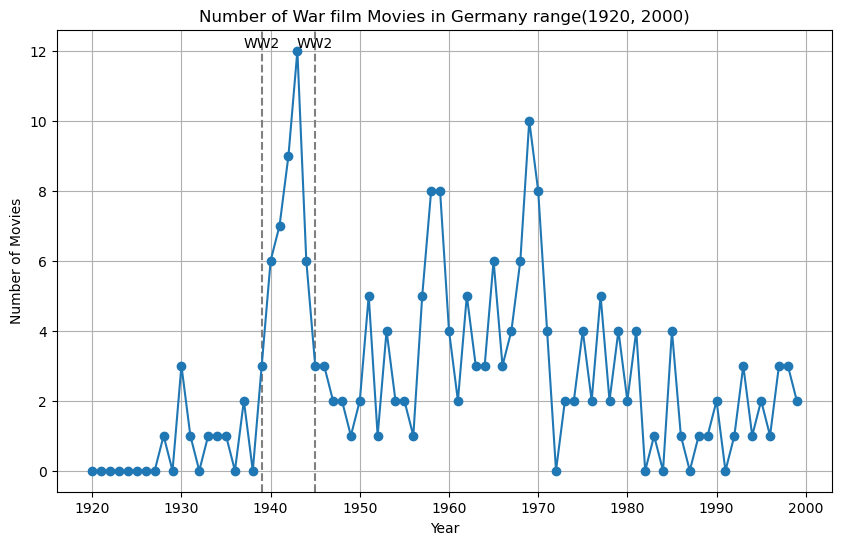

In [38]:
genre_trend_visualization("Germany", "War film", year_country_genre, range(1920, 2000), mark_years=[1939, 1945], mark_years_labels=['WW2', 'WW2'])

For Germany we observe a huge spike in the 1940 - 1950 which makes sense because of WW2 highlighted on the plot.

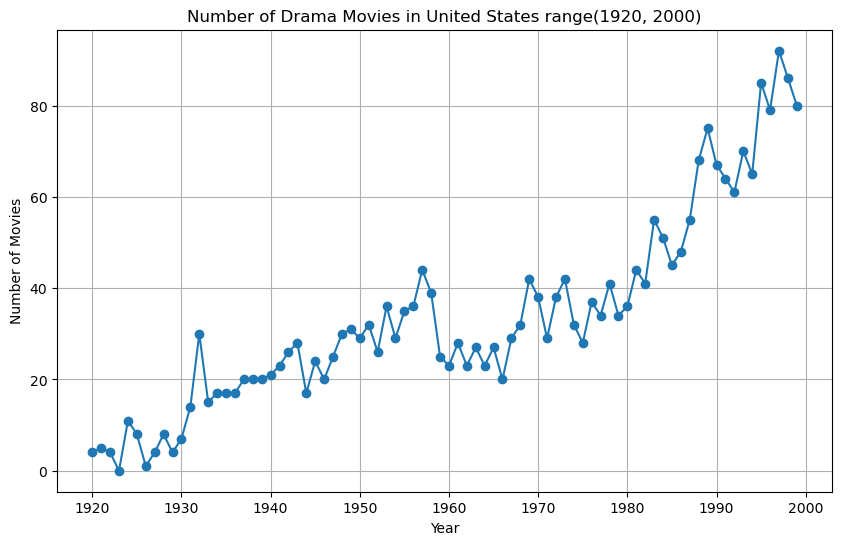

In [39]:
genre_trend_visualization("United States", "Drama", year_country_genre, range(1920, 2000))

For the United States we can observe a clear upwards and stable trajectory for drama movies showing no signs of slowing down. This can be both attributed to the larger number of movies that are being made in later years and to the popularity of drama movies.

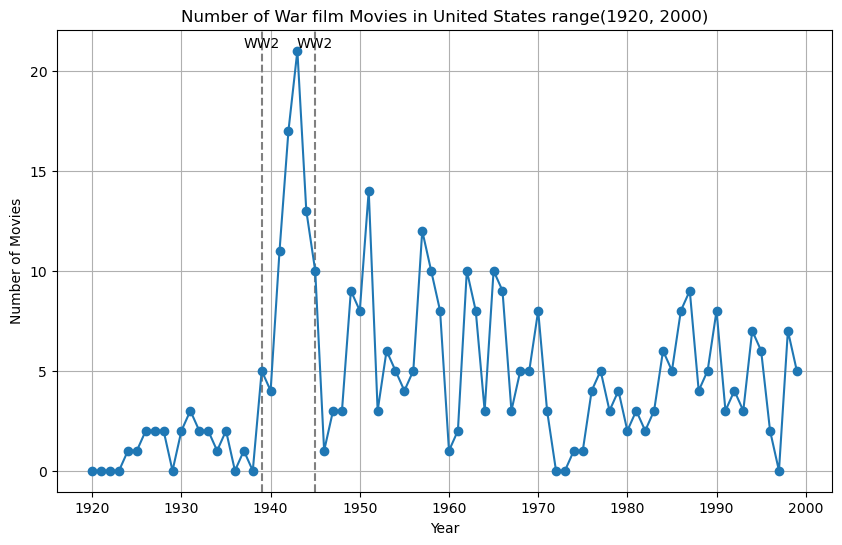

In [40]:
genre_trend_visualization("United States", "War film", year_country_genre, range(1920, 2000), mark_years=[1939, 1945], mark_years_labels=['WW2', 'WW2'])

If we instead analyze war movies involving the united states we can observe a clear downfall from the WW2 era.

## Character depiction and stereotypes

The view of the world is also influenced by the people.
In this part we would like to show the difference between real-life demographic data and cinema's own representation of people. 

#### Gender Representation 

We can do a short analysis of the ratio of Male/Female Actors in movies and compare it to real-life statistics. 

In [54]:
### Filter Nans 
filtered_character_metadata = character_metadata.dropna(subset=['Actor gender'])

In [55]:
# Merging the dataframes on Wikipedia movie ID
merged_data = pd.merge(filtered_character_metadata, movie_metadata, on='Wikipedia movie ID')

# Grouping by Country and Actor gender and counting
gender_counts = merged_data.groupby(['Country', 'Actor gender']).size().unstack(fill_value=0)

# Calculating the ratio of Male to Female characters for each country
gender_ratio = gender_counts['M'] / gender_counts['F']
gender_ratio = gender_ratio.reset_index().rename(columns={0: 'M/F ratio'})


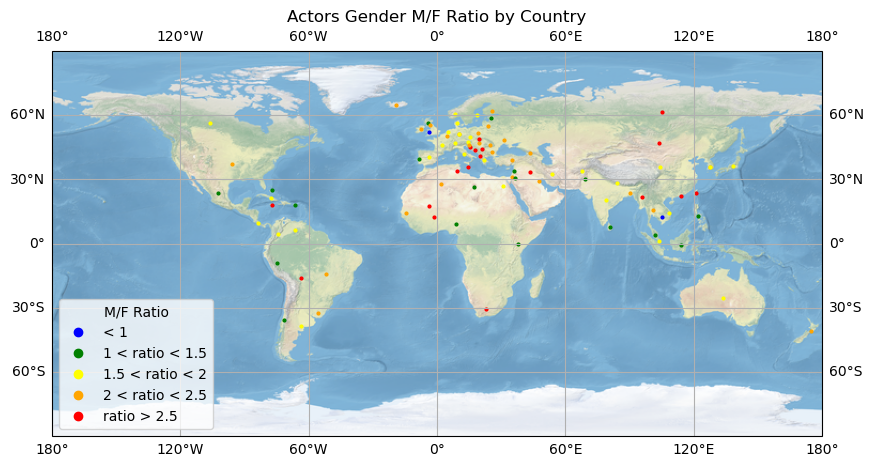

In [56]:
from helpers import get_color

gender_ratio['Latitude'] = gender_ratio['Country'].map(
    lambda x: country_coordinates[x][0] if x in country_coordinates else None
)
gender_ratio['Longitude'] = gender_ratio['Country'].map(
    lambda x: country_coordinates[x][1] if x in country_coordinates else None
)

# Filter out rows where Latitude or Longitude is None
gender_ratio = gender_ratio.dropna(subset=['Latitude', 'Longitude'])

# Create a plot with the PlateCarree projection
fig = plt.figure(figsize=(10, 5))
ax = plt.axes(projection=ccrs.PlateCarree())
ax.stock_img()

# Plot each country's gender ratio
for index, row in gender_ratio.iterrows():
    ratio = row['M/F ratio']
    lat, lon = row['Latitude'], row['Longitude']
    color = get_color(ratio)
    ax.plot(lon, lat, 'o', markersize=2, color = color)

# Add a custom legend
legend_labels = ['< 1', '1 < ratio < 1.5', '1.5 < ratio < 2', '2 < ratio < 2.5', 'ratio > 2.5']
legend_colors = ['blue', 'green', 'yellow', 'orange', 'red']
for label, color in zip(legend_labels, legend_colors):
    ax.plot([], [], 'o', color=color, label=label)

ax.legend(title='M/F Ratio')

ax.gridlines(draw_labels=True)

plt.title('Actors Gender M/F Ratio by Country')
plt.show()


Lets see the case of the United States & Russia

In [57]:
## Lets first get their index in gender_ratio
us_index = gender_ratio.index[gender_ratio['Country'] == 'United States'].tolist()
russia_index = gender_ratio.index[gender_ratio['Country'] == 'Russia'].tolist()

In [58]:
us_ratio = gender_ratio['M/F ratio'][us_index].values[0]
russia_ratio = gender_ratio['M/F ratio'][russia_index].values[0]

In [59]:
print(f" United States M/F Ratio : {us_ratio}")
print(f" Russia M/F Ratio : {russia_ratio}")

 United States M/F Ratio : 2.0863130047340572
 Russia M/F Ratio : 2.9496503496503497


We will neglect the evolution through time of such a value as it is very stable.

According to data from [The World Bank](https://data.worldbank.org/indicator/SP.POP.TOTL.FE.ZS?view=map), the gender ratio in the United States is close to one, while in Russia, it stands at 0.86.

These figures significantly diverge from the observed gender ratio in cinema. It's clear that there is a notable overrepresentation of men in the film industry

In [3]:
# We load from movie_analysis.json and convert to df
with open('data/movie_analysis.json', 'r') as f:
    analysis = json.load(f)

# We convert the string in the values to a dict
for key, value in analysis.items():
    analysis[key] = json.loads(value)

In [4]:
def get_characters(one_analysis):
    if one_analysis is None or 'characters' not in one_analysis:
        return []
    return one_analysis['characters']

def missing_values(value):
    if value in ['', 'None']:
        return None
    return value

character_data = []
for value in analysis.values():
    characters = get_characters(value)
    for character in characters:
        # Extracting nationality and alignment, convert empty strings and 'None' to None
        nationality = missing_values(characters[character].get('nationality')) if isinstance(characters[character], dict) else None
        alignment = missing_values(characters[character].get('alignment')) if isinstance(characters[character], dict) else None
        
        character_data.append({
            'character': character,
            'nationality': nationality,
            'alignment': alignment
        })

# initial Dataframe
characters = pd.DataFrame(character_data)

In [5]:
# filtering
characters_complete = characters[characters['nationality'].notna() & characters['alignment'].notna()]

# convert 'nationality' and 'alignment' columns to string
characters_complete['nationality'] = characters_complete['nationality'].astype(str)
characters_complete['alignment'] = characters_complete['alignment'].astype(str)

# keep only rows with 'good' or 'evil' alignment
filtered_characters = characters_complete[characters_complete['alignment'].isin(['good', 'evil'])]

# group by nationality and alignment, then count
grouped_characters = filtered_characters.groupby(['nationality', 'alignment']).size()

final_table = grouped_characters.unstack().fillna(0)
final_table.columns = ['evil counter', 'good counter']
final_table.reset_index(inplace=True)

In [ ]:
import pycountry 

# dictionary to hold variations that are not handled by pycountry
country_variations = {
    'Inuit':'Antartica',
    'US': 'United States',
    'USA': 'United States',
    'UK': 'United Kingdom',
    'U.K.': 'United Kingdom',
    'Russia': 'Russian Federation',
    'USSR': 'Russian Federation',
    'Belgian':'Belgium',
    'Hispanic':'Spain',
    'German':'Germany',
    'Czech':'Czechia',
    'Czecholsovakia':'Czechia',
    'Venezuela':'Venezuela, Bolivarian Republic of',
    'Bolivia':'Bolivia, Plurinational State of',
    'Syria':'Syrian Arab Republic',
    'Vietnam': 'Viet Nam',
}

valid_countries = {country.name for country in pycountry.countries}

def standardize_nationality(nationality):
    # return the standardized name if it's in the country_variations
    if nationality in country_variations:
        return country_variations[nationality]

    # apply the 'n' ending logic only if the nationality is not in country_variations
    if nationality.endswith('n'):
        possible_country = nationality[:-1]
        for country in pycountry.countries:
            if country.name.startswith(possible_country):
                return country.name

    # return the original nationality if no match found
    return nationality

# apply the standardize_nationality function
final_table['nationality'] = final_table['nationality'].apply(standardize_nationality)

# check if a country name is valid
def is_valid_country(country_name):
    # Check direct match or variation
    standardized_country = country_variations.get(country_name, country_name)
    return standardized_country in valid_countries

# fuse similar nationalities and sum the counters
final_table = final_table.groupby('nationality').agg({'evil counter': 'sum', 'good counter': 'sum'}).reset_index()

# filter out invalid nationalities
valid_nationalities_df = final_table[final_table['nationality'].apply(is_valid_country)]

print(valid_nationalities_df)

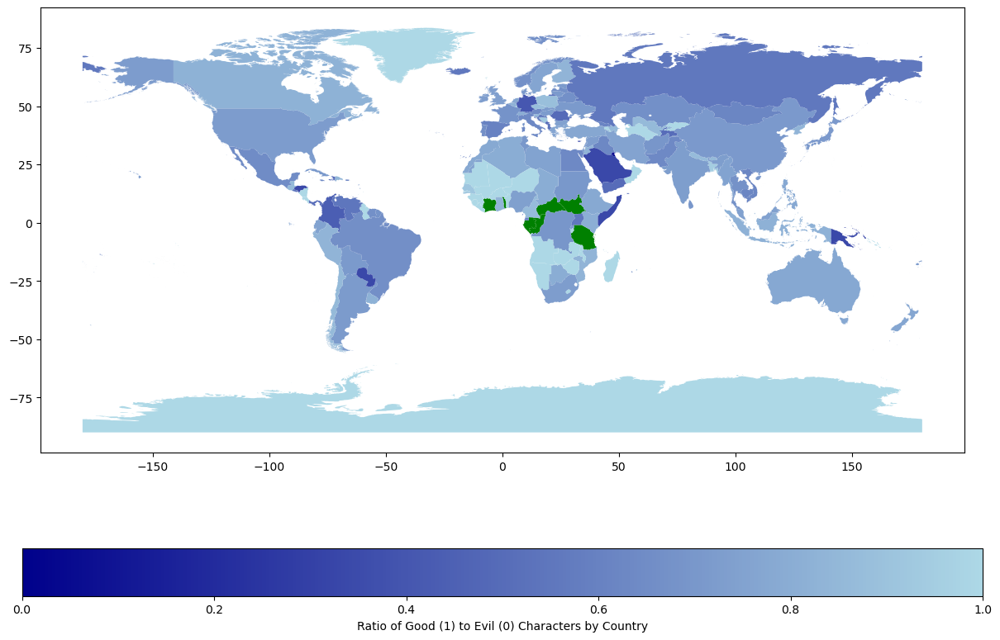

In [16]:
import geopandas as gpd
import matplotlib.colors as mcolors

geojson_path = 'data/countries.geojson'

# load GeoJSON file 
gdf_world = gpd.read_file(geojson_path)

# reconversion from pycountry to GeoJSON
country_name_mapping = {
    'United States': 'United States of America',
    'Russian Federation': 'Russia',
    'Congo': 'Democratic Republic of the Congo',
    'Iran, Islamic Republic of':'Iran',
    'Korea, Republic of':'North Korea',
    'Bolivia, Plurinational State of':'Bolivia',
    'Venezuela, Bolivarian Republic of':'Venezuela',
    'Syrian Arab Republic':'Syria',
    'Czechia':'Czech Republic',
    'Viet Nam':'Vietnam',
}

# conversion of country names
valid_nationalities_df['nationality'] = valid_nationalities_df['nationality'].replace(country_name_mapping)

# good to evil ratio
valid_nationalities_df['good_evil_ratio'] = valid_nationalities_df['good counter'] / (valid_nationalities_df['evil counter'] + valid_nationalities_df['good counter'])

# merge with the GeoDataFrame
merged_gdf = gdf_world.set_index('ADMIN').join(valid_nationalities_df.set_index('nationality'))

# define colors for specific countries
specific_countries_colors = {'South Sudan': 'grey', 'Tanzania': 'grey', 'Ivory Coast':'grey', 
                             'Togo':'grey', 'Gabon':'grey', 'Republic of Congo':'grey',
                             'Central African Republic':'grey', 'United Republic of Tanzania':'grey'}

cmap = mcolors.LinearSegmentedColormap.from_list("", ["darkblue", "lightblue"])
fig, ax = plt.subplots(1, 1, figsize=(15, 10))

# check if the country exists in the GeoDataFrame
for country, color in specific_countries_colors.items():
    if country in gdf_world['ADMIN'].values:
        gdf_world[gdf_world['ADMIN'] == country].plot(ax=ax, color=color)

# plot other countries with the colormap
merged_gdf.dropna(subset=['good_evil_ratio']).plot(column='good_evil_ratio', ax=ax, legend=True, cmap=cmap,
                legend_kwds={'label': "Ratio of Good (1) to Evil (0) Characters by Country",
                             'orientation': "horizontal"})

ax.set_aspect('equal')

plt.show()

The resulting visualization displays a world map where each country's color intensity reflects the proportion of good characters in the analyzed data. Countries in lighter blue have a higher proportion of good characters, while those in darker blue have a lower proportion. Countries highlighted in green, such as South Sudan, Ivory Coast, Tanzania, Central African Republic, Gabon, and Togo, represent areas with insufficient data for the analysis. This geographical representation allows for a quick visual assessment of the distribution of character alignments around the world based on the dataset.

In [65]:
# now selecting only 'character' and 'nationality' columns
characters_nationality = characters[['character', 'nationality']]

# filtering
characters_nationality = characters_nationality[characters_nationality['nationality'].notna()]

# convert 'nationality' and 'character' columns to string
characters_nationality['nationality'] = characters_nationality['nationality'].astype(str)
characters_nationality['character'] = characters_nationality['character'].astype(str)

# apply the standardize_nationality function (defined in the previous cell)
characters_nationality['nationality'] = characters_nationality['nationality'].apply(standardize_nationality)

# filter out invalid nationalities
characters_nationality_valid = characters_nationality[characters_nationality['nationality'].apply(is_valid_country)]

In [66]:
characters_nationality_valid['first_name'] = characters_nationality_valid['character'].apply(lambda x: x.split()[0] if x.split() else x)

# group by nationality and first name and count occurrences
first_name_counts = characters_nationality_valid.groupby(['nationality', 'first_name']).size().reset_index(name='count')

first_name_counts_sorted = first_name_counts.sort_values(['nationality', 'count'], ascending=[True, False])
first_name_counts_sorted = first_name_counts_sorted.reset_index(drop=True)

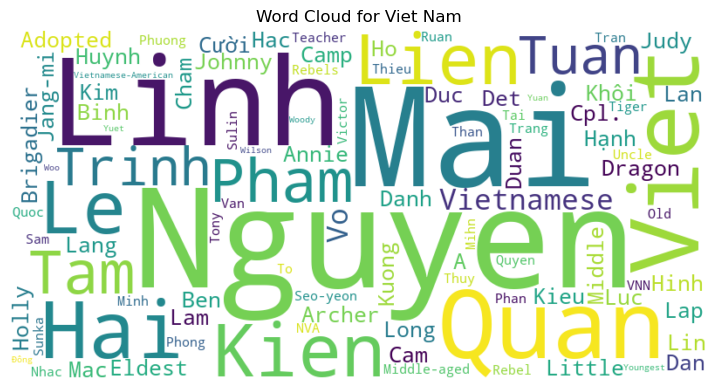

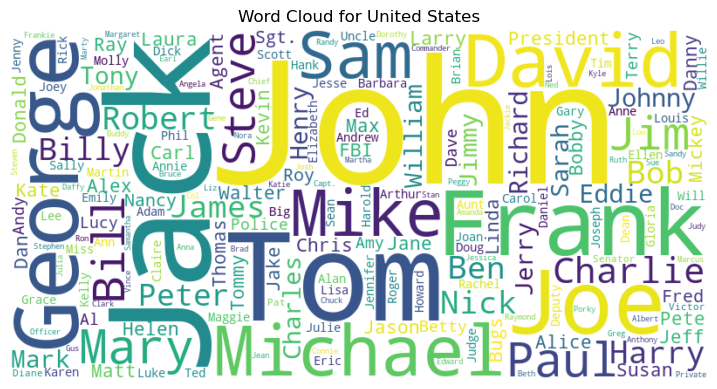

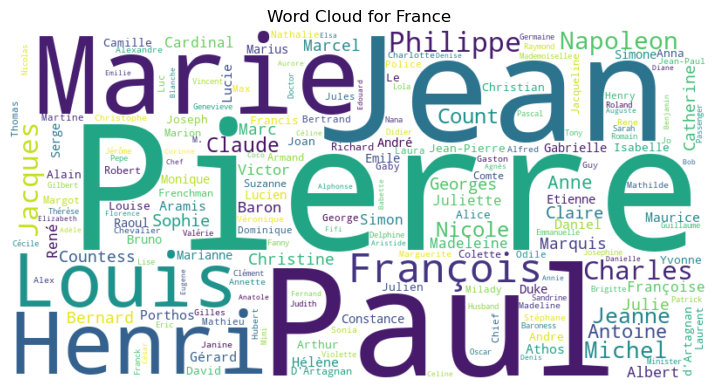

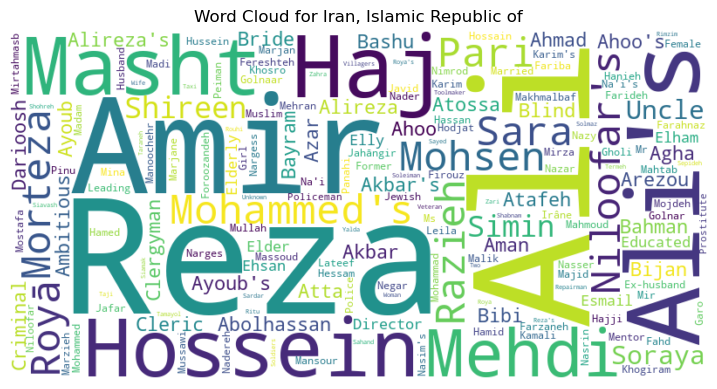

In [72]:
from wordcloud import WordCloud

invalid_names = ['Mr.', 'Dr.', 'Mrs.', 'Ms.', 'Prof.', 'Sir', 'Detective', 'Professor', 'Inspector', 
                 'Colonel', 'Lieutenant', 'Sheriff', 'Lt.', 'Captain', 'The', 'Major', 'British', 'Lady',
                 'American', 'German', 'General', 'French', 'Don', 'Greek', 'Madame', 'Monsieur', 'Father',
                 'Mother', 'King', 'Queen', 'Young', 'Master', 'Lord', 'Sergeant', 'Thai', 'Russian',
                 'Princess', 'Prince', 'Soviet', 'Iranian', 'Brother', 'Sister'] 

def generate_wordcloud_for_country(df, country):
    country_data = first_name_counts_sorted[first_name_counts_sorted['nationality'] == country]
    
    # remove rows with invalid first names
    country_data = country_data[~country_data['first_name'].isin(invalid_names)]

    # dictionary of first names and their counts
    names_dict = dict(zip(country_data['first_name'], country_data['count']))

    # generate a word cloud
    wordcloud = WordCloud(width=800, height=400, background_color='white').generate_from_frequencies(names_dict)

    plt.figure(figsize=(9, 12))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis('off')
    plt.title(f'Word Cloud for {country}')
    plt.show()

# list of countries 
countries = ['Viet Nam', 'United States', 'France', 'Iran, Islamic Republic of']

for country in countries:
    generate_wordcloud_for_country(df, country)

This visualization displays the word clouds generated for these countries, where the size of each name represents its frequency or prevalence in the dataset. These word clouds provide a graphical representation of the most common names associated with characters from different national backgrounds in movies, offering an interesting cultural insight into name usage in cinematic contexts. For instance, we see "Nguyen" as a prominent name in the Vietnam word cloud, reflecting its commonality in Vietnamese culture. Similarly, classic Western names dominate the clouds for the United States and France, and the Iranian cloud shows a mix of traditional Persian names.